In [1]:
import sys
import os
# Agrega la raíz del proyecto al path
project_root = os.path.abspath(os.path.join(os.getcwd(), ".."))
if project_root not in sys.path:
    sys.path.insert(0, project_root)

In [2]:
# ──────────────────────────────────────────────────────────────────────────────────────────────────
# CELDA 1: Imports básicos, configuración de matplotlib y parámetros generales
# ──────────────────────────────────────────────────────────────────────────────────────────────────
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Para que las imágenes de matplotlib se muestren correctamente en Jupyter
%matplotlib inline
plt.rcParams["figure.figsize"] = (12, 8)


# ──────────────────────────────────────────────────────────────────────────────────────────────────
# CELDA 2: Importar funciones auxiliares desde nuestro script
# ──────────────────────────────────────────────────────────────────────────────────────────────────

# Asumimos que el archivo "auxiliares.py" está una carpeta por encima de notebooks/, 
# o en la misma carpeta de scripts. Ajusta la ruta si es necesario.
import sys
sys.path.append(os.path.abspath(os.path.join(os.getcwd(), "..", "scripts")))

from scripts.prep_auxiliares_v2 import (
    recortar_tanque_con_desplazamiento_superior,
    eliminar_timestamp_manualmente,
    supresion_reflejos_gamma,
    balance_blancos_simple,
    ajustar_brillo_contraste,
    separar_peces_con_watershed,
    filtro_contornos_por_forma
)
# NOTA: segmentar_peces_color_gris_naranja lo implementaremos “inline” más abajo.


### Preprocesamiento paso a paso con n imagenes

In [3]:
# ──────────────────────────────────────────────────────────────────────────────────────────────────
# CELDA 3: Configurar rutas, leer CSV de etiquetas y muestrear imágenes por clase
# ──────────────────────────────────────────────────────────────────────────────────────────────────

# 1) Rutas y parámetros generales
labels_csv        = "../data/labels_etiquetado_v2.csv"
image_dir         = "../data/images"
output_root       = "../data/dataset_procesado"  # no se utiliza para guardar en este notebook, solo para referencia
df                = pd.read_csv(labels_csv)

classes           = ["saludable", "estres_leve", "enfermo"]
samples_per_class = 5   # Cantidad de imágenes aleatorias que mostraremos por cada clase

# 2) Tomar muestra aleatoria de imágenes por clase
muestras_por_clase = {}
for cls in classes:
    df_cls = df[df["etiqueta_rel"] == cls]
    if len(df_cls) >= samples_per_class:
        muestras_por_clase[cls] = df_cls.sample(samples_per_class, random_state=42)["imagen"].tolist()
    else:
        muestras_por_clase[cls] = df_cls["imagen"].tolist()
        print(f"Advertencia: Sólo {len(df_cls)} imágenes para clase '{cls}'.")


In [8]:
# ──────────────────────────────────────────────────────────────────────────────────────────────────
# CELDA 4: Definir rangos y parámetros
# ──────────────────────────────────────────────────────────────────────────────────────────────────

# A) Rangos HSV afinados para identificar sombras
h_min_oliva, h_max_oliva = 55, 65      # Reducido para solo “verde-oliva” real
s_max_oliva = 40
s_max_blanco, v_min_blanco = 0, 220   # Ajustado: S muy bajo y V alto (>200) para “blanco-verdoso”

# B) Rangos HSV para “peces naranja/rojizo” (sin cambios)
#    Afinamos para capturar solo tonos “koi” bien saturados,
#    no naranjas pálidos que sean confundidos con el fondo.

lower1 = np.array([10, 150, 150])
upper1 = np.array([20, 255, 255])
lower2 = np.array([170, 150, 150])
upper2 = np.array([179, 255, 255])

# C) Parámetros adaptativos LAB para “peces gris/plateados”
#    Podemos ajustar empíricamente en este ejemplo, pero es recomendable calcular
#    media±2σ sobre una muestra de peces para determinar estos valores:
umbral_L = 110      # Bajamos de 140 a 120 para incluir tonos más oscuros de pez grisáceo
delta_ab = 40      # Ampliamos a 30 para captar matices más verdosos/atresados

# D) Parámetros para peces blancos
umbral_L_blanco_pez = 200   # L muy alto
s_max_blanco_pez = 80       # Saturación muy baja

# E) Parámetro para peces negros (V muy bajo)
v_max_negro_pez = 60

# F) Área mínima (px) absoluta para lo que consideramos “silhouette de pez” tras fallback
area_min_abs = 100

# G) Área mínima relativa para el primer filtrado de contornos (antes de forma)
area_min_rel = 30   # Se mantiene 20 px para la máscara cruda antes del forma

# H) Parámetros de forma
min_circularity = 0.15
aspect_ratio_range = (1.2, 6.0)

# I) Parámetros de salida final
TAM_FINAL = (224, 224)

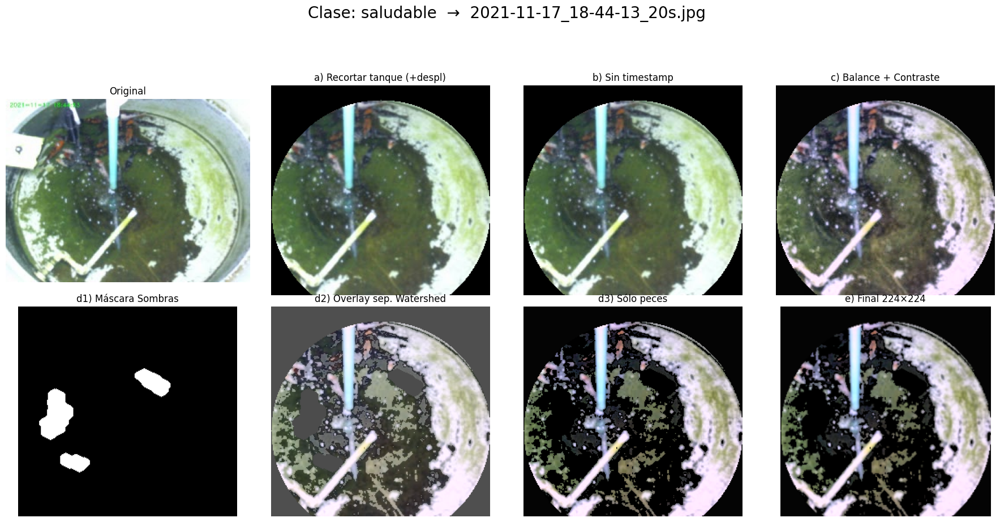

>>> Rangos HSV peces: H 0 - 179 | S 0 - 164 | V 0 - 255
>>> Rangos LAB peces: L 0 - 248 | a 108 - 152 | b 98 - 168

--------------------------------------------------------------------------------



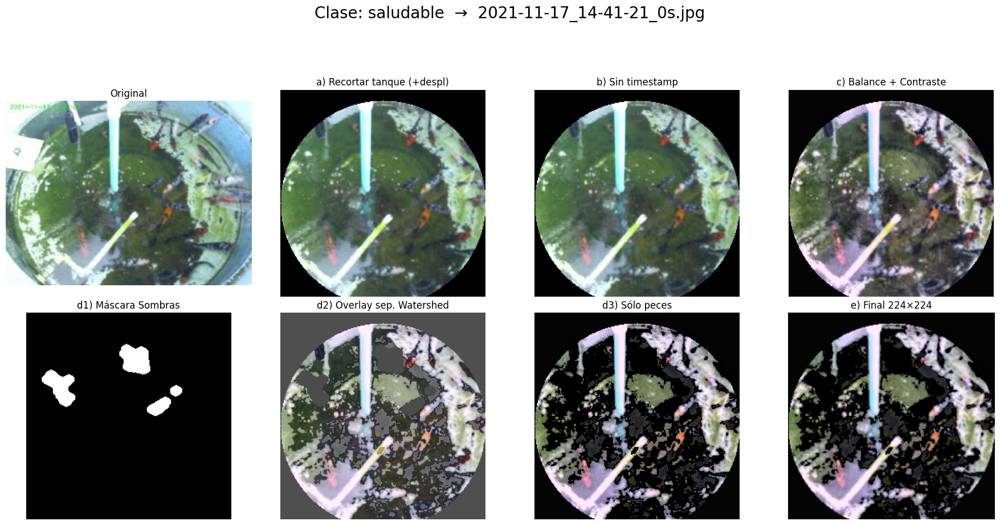

>>> Rangos HSV peces: H 0 - 179 | S 0 - 192 | V 0 - 255
>>> Rangos LAB peces: L 0 - 250 | a 110 - 172 | b 101 - 183

--------------------------------------------------------------------------------



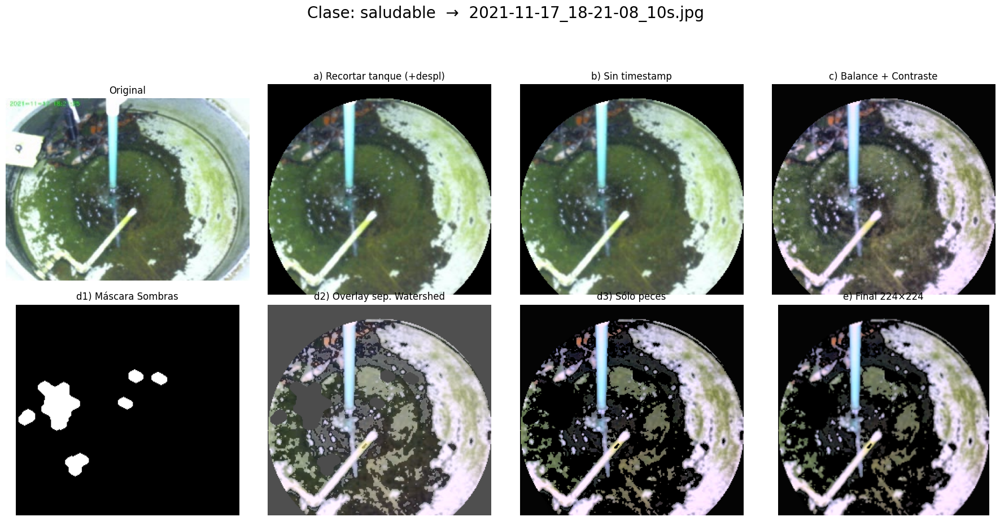

>>> Rangos HSV peces: H 0 - 179 | S 0 - 225 | V 0 - 255
>>> Rangos LAB peces: L 0 - 248 | a 107 - 158 | b 97 - 168

--------------------------------------------------------------------------------



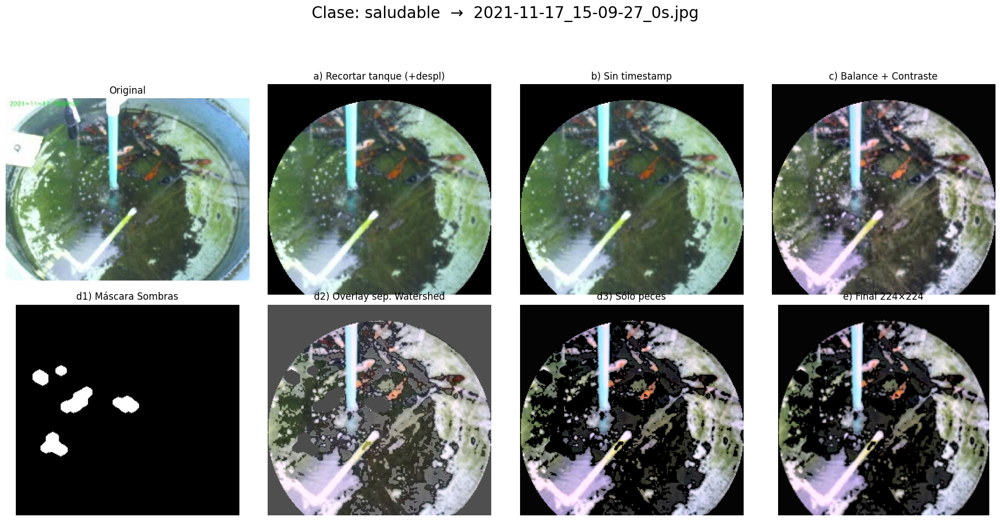

>>> Rangos HSV peces: H 0 - 179 | S 0 - 203 | V 0 - 255
>>> Rangos LAB peces: L 0 - 250 | a 107 - 170 | b 99 - 182

--------------------------------------------------------------------------------



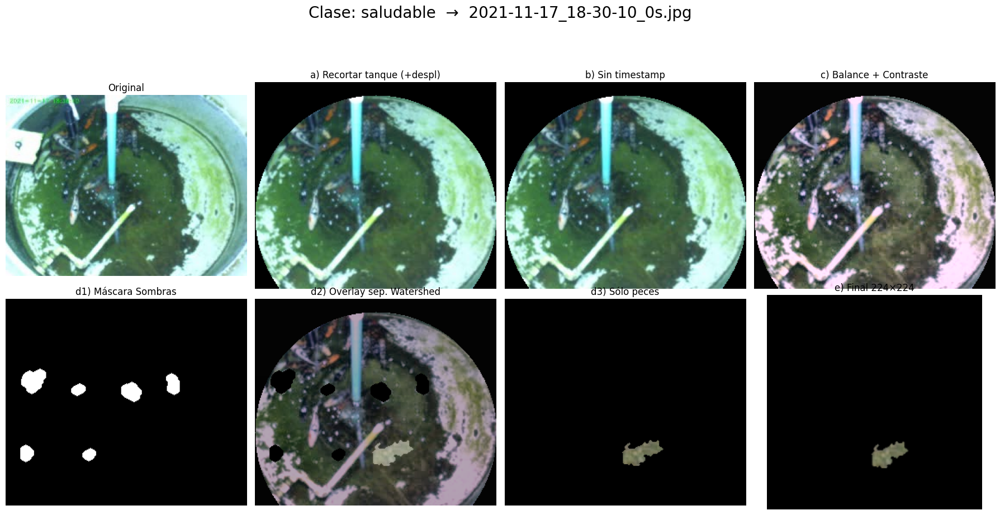

>>> Rangos HSV peces: H 19 - 46 | S 20 - 87 | V 87 - 154
>>> Rangos LAB peces: L 94 - 155 | a 117 - 128 | b 132 - 147

--------------------------------------------------------------------------------



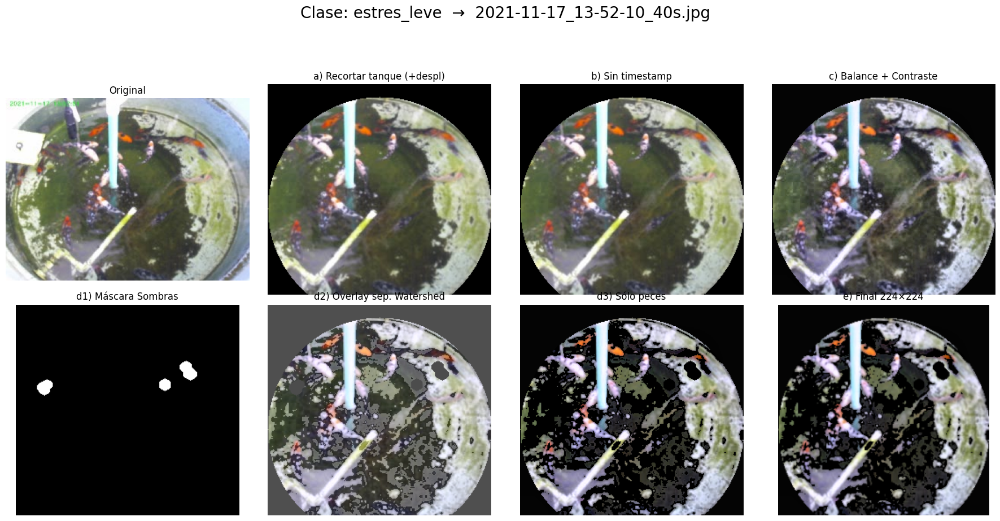

>>> Rangos HSV peces: H 0 - 179 | S 0 - 255 | V 0 - 255
>>> Rangos LAB peces: L 0 - 253 | a 111 - 179 | b 95 - 195

--------------------------------------------------------------------------------



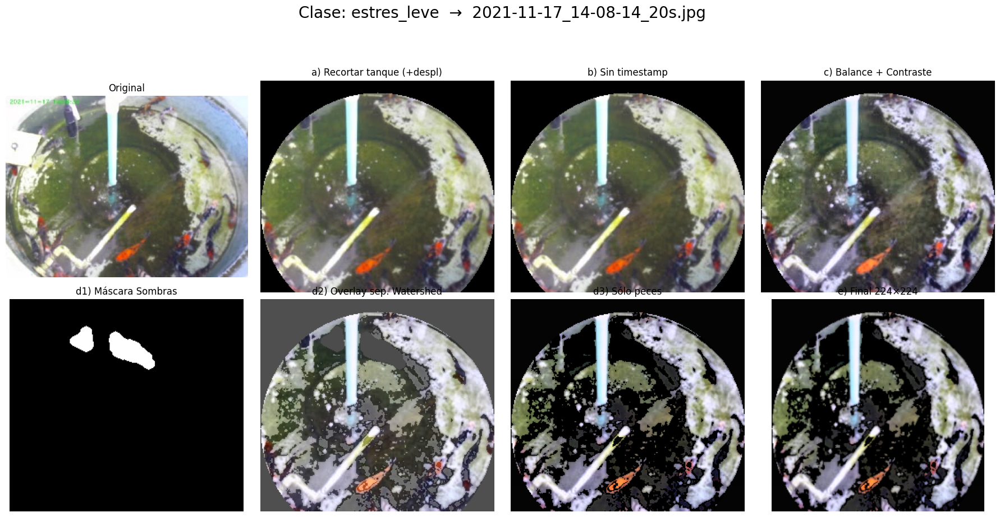

>>> Rangos HSV peces: H 0 - 179 | S 0 - 202 | V 0 - 255
>>> Rangos LAB peces: L 0 - 252 | a 110 - 177 | b 96 - 189

--------------------------------------------------------------------------------



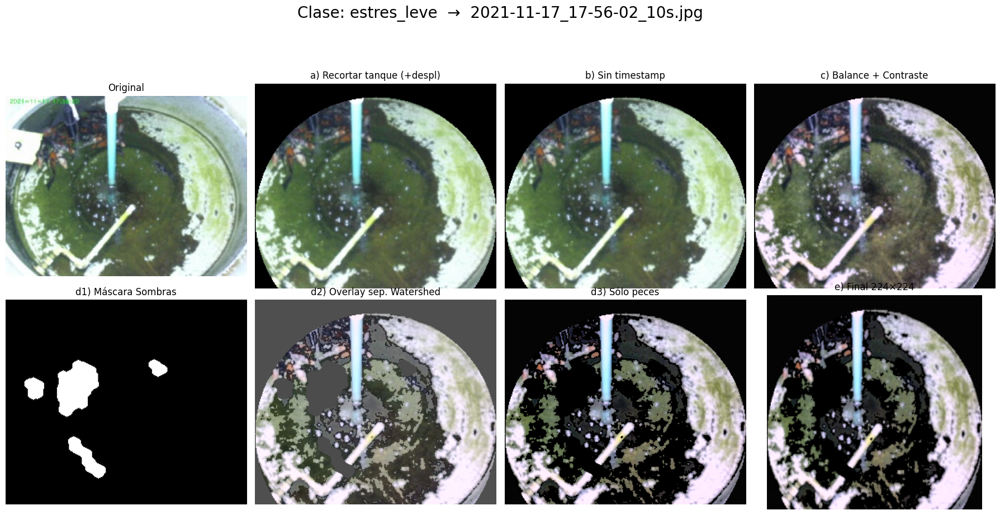

>>> Rangos HSV peces: H 0 - 179 | S 0 - 216 | V 0 - 255
>>> Rangos LAB peces: L 0 - 250 | a 105 - 158 | b 97 - 168

--------------------------------------------------------------------------------



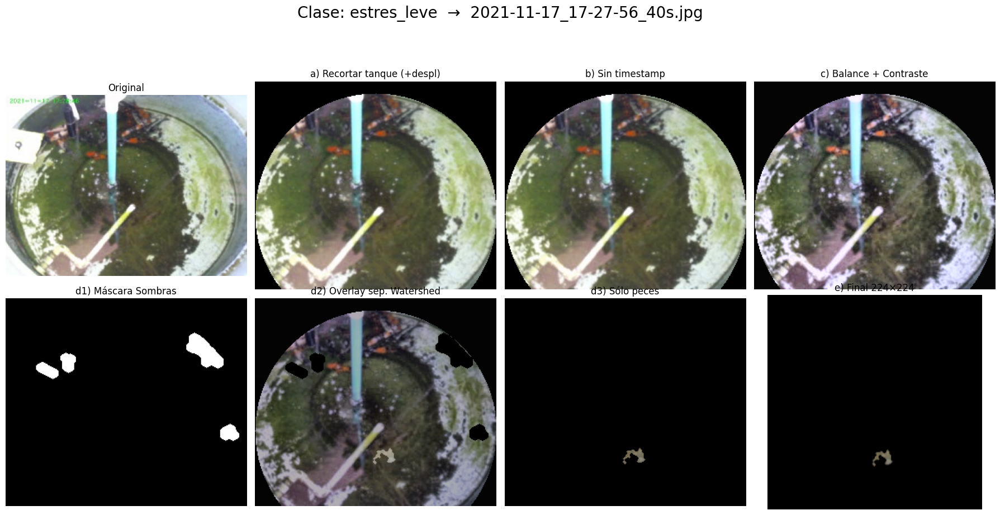

>>> Rangos HSV peces: H 12 - 32 | S 24 - 97 | V 99 - 140
>>> Rangos LAB peces: L 101 - 144 | a 124 - 132 | b 133 - 148

--------------------------------------------------------------------------------



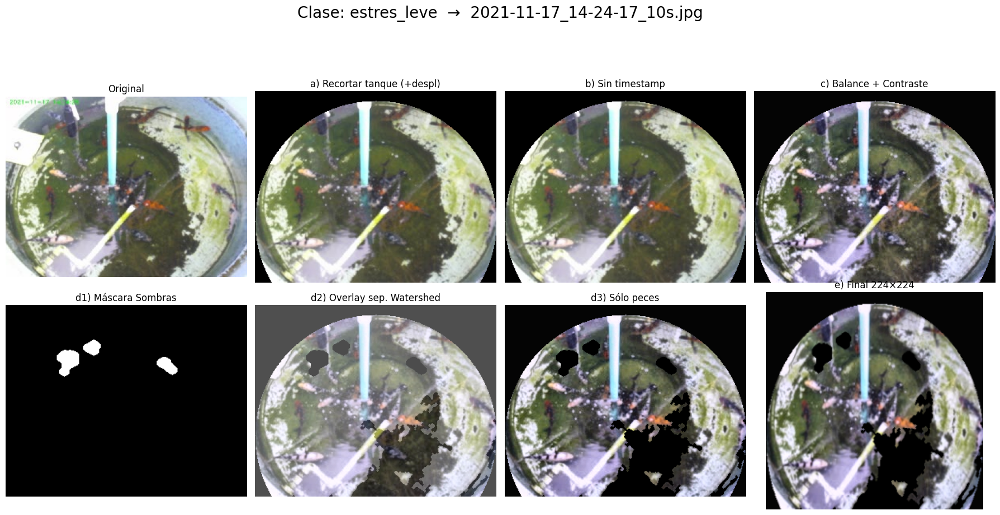

>>> Rangos HSV peces: H 0 - 179 | S 0 - 187 | V 0 - 255
>>> Rangos LAB peces: L 0 - 254 | a 106 - 164 | b 97 - 179

--------------------------------------------------------------------------------



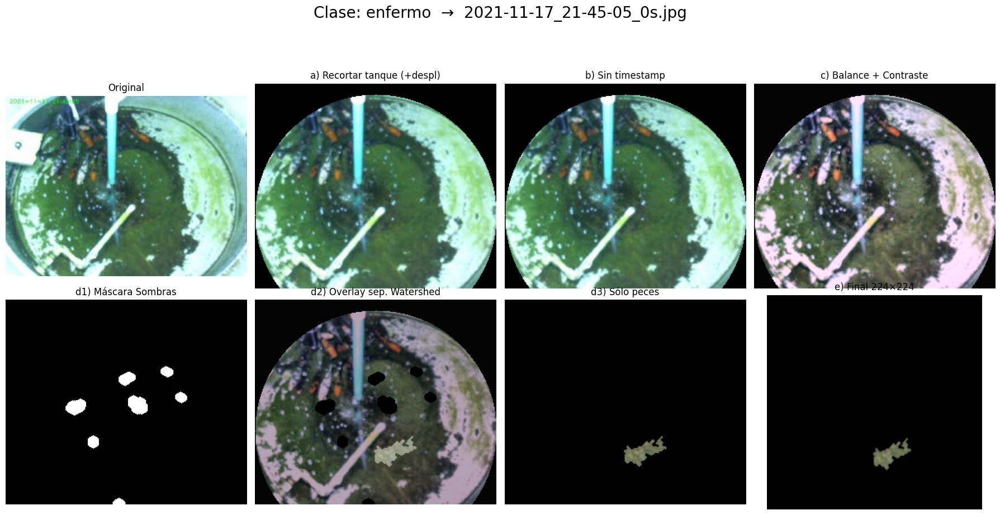

>>> Rangos HSV peces: H 19 - 49 | S 36 - 89 | V 94 - 147
>>> Rangos LAB peces: L 97 - 154 | a 116 - 129 | b 136 - 149

--------------------------------------------------------------------------------



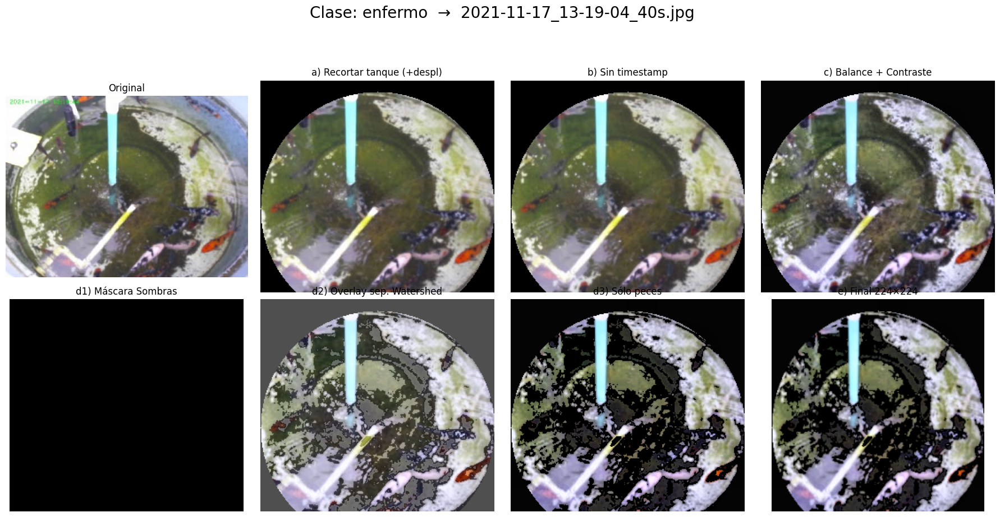

>>> Rangos HSV peces: H 0 - 179 | S 0 - 247 | V 3 - 255
>>> Rangos LAB peces: L 2 - 254 | a 103 - 177 | b 94 - 187

--------------------------------------------------------------------------------



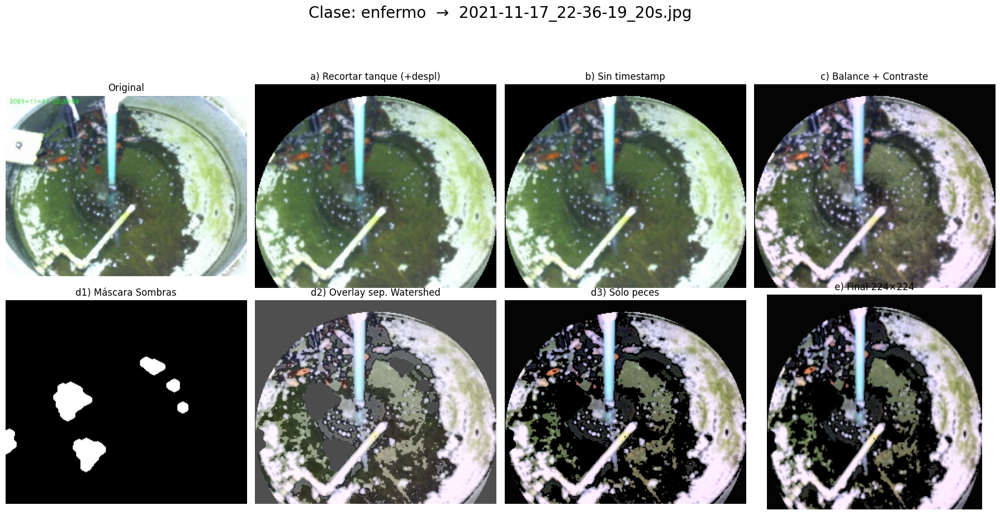

>>> Rangos HSV peces: H 0 - 179 | S 0 - 197 | V 0 - 255
>>> Rangos LAB peces: L 0 - 250 | a 107 - 168 | b 99 - 178

--------------------------------------------------------------------------------



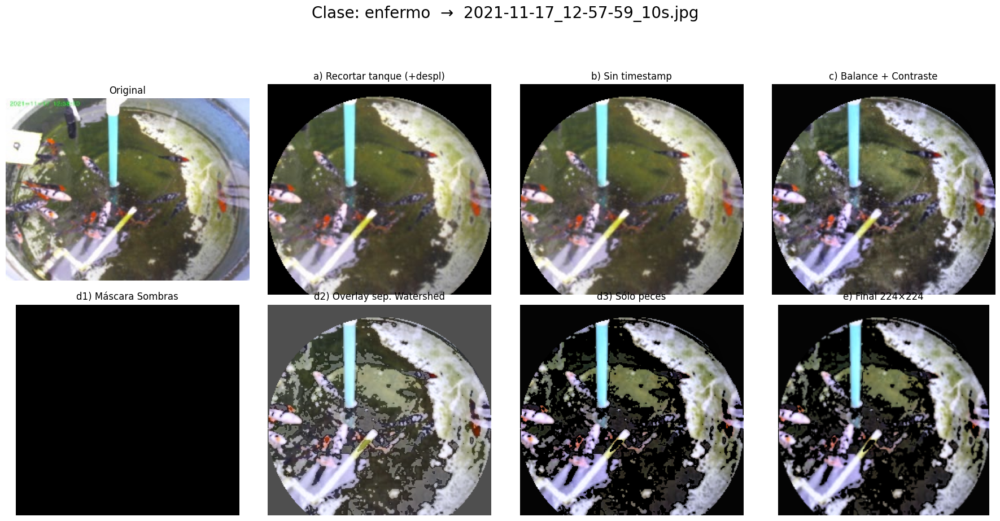

>>> Rangos HSV peces: H 0 - 179 | S 0 - 255 | V 2 - 255
>>> Rangos LAB peces: L 1 - 254 | a 99 - 171 | b 92 - 178

--------------------------------------------------------------------------------



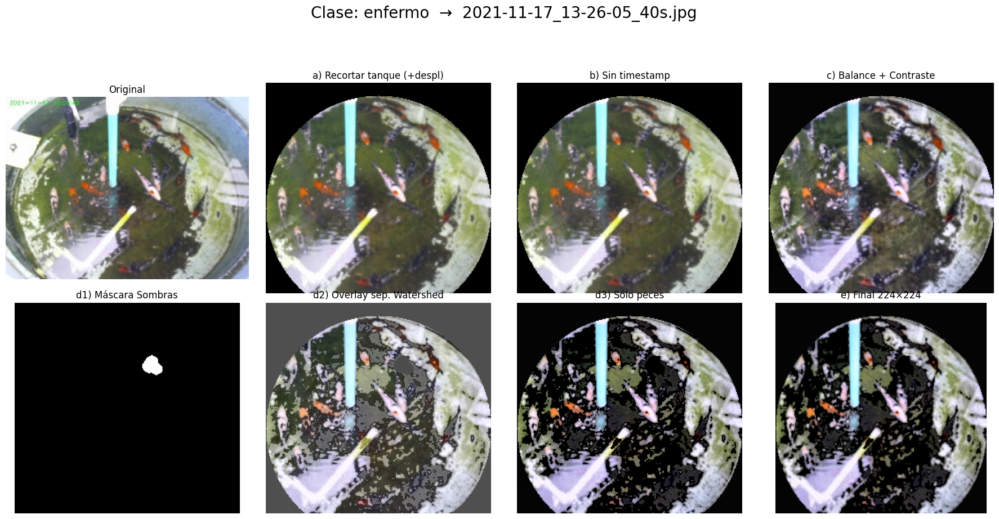

>>> Rangos HSV peces: H 0 - 179 | S 0 - 255 | V 0 - 255
>>> Rangos LAB peces: L 0 - 252 | a 104 - 174 | b 99 - 190

--------------------------------------------------------------------------------



In [12]:
# ──────────────────────────────────────────────────────────────────────────────────────────────────
# CELDA 5: Bloque de preprocesamiento VISUAL con los nuevos rangos
# ──────────────────────────────────────────────────────────────────────────────────────────────────

for cls in classes:
    imgs = muestras_por_clase[cls]
    for img_name in imgs:
        img_path = os.path.join(image_dir, img_name)
        img_original = cv2.imread(img_path)
        if img_original is None:
            continue

        # ─────────── a) Recorte del tanque (+ desplazamiento) ───────────
        roi = recortar_tanque_con_desplazamiento_superior(img_original, desplazar_arriba=50)

        # ─────────── b) Eliminar timestamp ───────────
        sin_ts = eliminar_timestamp_manualmente(roi, alto_ts=5, ancho_ts=250)

        # ─────────── c) Balance de blancos + CLAHE ───────────
        wb = balance_blancos_simple(sin_ts)
        eq = ajustar_brillo_contraste(wb)

        # ─────────── d) Detectar y eliminar sombras (HSV) ───────────
        hsv_eq = cv2.cvtColor(eq, cv2.COLOR_BGR2HSV)
        h_chan, s_chan, v_chan = cv2.split(hsv_eq)

        # (1) Sombra verde-oliva muy saturado: H ∈ [50,70], S < 50
        mask_h_oliva = cv2.inRange(h_chan, h_min_oliva, h_max_oliva)
        mask_s_oliva = cv2.inRange(s_chan, 0, s_max_oliva)
        mask_oliva   = cv2.bitwise_and(mask_h_oliva, mask_s_oliva)

        # (2) Sombra blanco-verdosa muy restrictiva: S < 40, V > 210
        mask_s_blanco = cv2.inRange(s_chan, 0, s_max_blanco)
        mask_v_blanco = cv2.inRange(v_chan, v_min_blanco, 255)
        mask_blanco   = cv2.bitwise_and(mask_s_blanco, mask_v_blanco)

        # (3) Unión de ambas máscaras de sombra
        mask_shadow = cv2.bitwise_or(mask_oliva, mask_blanco)

        # (4) Limpiar máscara de sombras (morph 7×7)
        kernel_s = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (7, 7))
        mask_shadow = cv2.morphologyEx(mask_shadow, cv2.MORPH_CLOSE, kernel_s, iterations=2)
        mask_shadow = cv2.morphologyEx(mask_shadow, cv2.MORPH_OPEN,  kernel_s, iterations=2)

        # (5) Invertir ⇒ zonas “sin sombra”
        mask_no_shadow = cv2.bitwise_not(mask_shadow)

        # (6) Aplicar sobre la imagen corregida para quitar sombras
        eq_sin_sombra = cv2.bitwise_and(eq, eq, mask=mask_no_shadow)

        # ─────────── e) Segmentar peces por color (HSV + LAB) ───────────
        hsv2 = cv2.cvtColor(eq_sin_sombra, cv2.COLOR_BGR2HSV)
        lab2 = cv2.cvtColor(eq_sin_sombra, cv2.COLOR_BGR2LAB)
        L2, a2, b2 = cv2.split(lab2)

        # e.1) Peces naranja/rojizo (HSV solo tonos vivos)
        m1 = cv2.inRange(hsv2, lower1, upper1)
        m2 = cv2.inRange(hsv2, lower2, upper2)
        mask_naranja = cv2.bitwise_or(m1, m2)

        # e.2) Peces gris/plateado (LAB muy amplio)
        mask_L = cv2.inRange(L2, umbral_L, 255)
        mask_a = cv2.inRange(a2, 128 - delta_ab, 128 + delta_ab)
        mask_b = cv2.inRange(b2, 128 - delta_ab, 128 + delta_ab)
        mask_gris = cv2.bitwise_and(mask_L, cv2.bitwise_and(mask_a, mask_b))

        # e.3) Peces blancos (LAB L ≥ 180; saturación moderada ≤ 120)
        mask_blanco_pez = cv2.inRange(L2, umbral_L_blanco_pez, 255)
        sat_channel = hsv2[:, :, 1]
        mask_S_bajo_pez = cv2.inRange(sat_channel, 0, s_max_blanco_pez)
        mask_blanco_pez = cv2.bitwise_and(mask_blanco_pez, mask_S_bajo_pez)

        # e.4) Peces negros (canal V ≤ 90)
        val_channel = hsv2[:, :, 2]
        mask_negro_pez = cv2.inRange(val_channel, 0, v_max_negro_pez)

        # e.5) Combinar todas las máscaras de peces
        mask_comb1 = cv2.bitwise_or(mask_naranja, mask_gris)
        mask_comb2 = cv2.bitwise_or(mask_blanco_pez, mask_negro_pez)
        mask_comb  = cv2.bitwise_or(mask_comb1, mask_comb2)

        # e.6) Limpieza inicial con morph (kernel 3×3)
        kernel_p = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
        mask_close = cv2.morphologyEx(mask_comb, cv2.MORPH_CLOSE, kernel_p, iterations=1)
        mask_clean = cv2.morphologyEx(mask_close, cv2.MORPH_OPEN,  kernel_p, iterations=1)

        # e.7) “Segmentado crudo” (solo para inspección)
        seg_crudo = cv2.bitwise_and(eq_sin_sombra, eq_sin_sombra, mask=mask_clean)

        # ─────────── f) Filtrar contornos por área mínima relativa (≥20 px) ───────────
        contours, _ = cv2.findContours(mask_clean, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        mask_filtered = np.zeros_like(mask_clean)
        for cnt in contours:
            if cv2.contourArea(cnt) >= area_min_rel:
                cv2.drawContours(mask_filtered, [cnt], -1, 255, -1)

        # ─────────── g) Fallback moderado: si mask_filtered queda casi vacío, usar mask_comb ───────────
        if cv2.countNonZero(mask_filtered) < area_min_rel:
            mask_filtered = mask_comb.copy()

        # ─────────── h) Separar peces agrupados con Watershed ───────────
        markers_ws = separar_peces_con_watershed(mask_filtered)
        unique_markers = np.unique(markers_ws)

        mask_sep = np.zeros_like(mask_filtered)
        for m in unique_markers:
            if m <= 1:  # 0 = borde, 1 = fondo
                continue
            mask_sep[markers_ws == m] = 255

        # Si Watershed no genera ≥2 regiones (solo fondo+1), volvemos a mask_filtered
        if len(unique_markers) - 2 <= 1:
            mask_sep = mask_filtered.copy()

        # ─────────── i) Filtro final por forma/circularidad ───────────
        mask_final_forma = filtro_contornos_por_forma(
            mask_sep,
            min_area_abs=area_min_abs,
            min_circularity=min_circularity,
            aspect_ratio_range=aspect_ratio_range
        )

        # j) Si mask_final_forma queda vacío, devolvemos mask_comb como última medida
        if cv2.countNonZero(mask_final_forma) < area_min_rel:
            mask_final_forma = mask_comb.copy()

        # k) “Sólo peces” aplicando máscara final
        seg_separado = cv2.bitwise_and(eq_sin_sombra, eq_sin_sombra, mask=mask_final_forma)

        # l) Overlay con máscara final
        mask_col = cv2.cvtColor(mask_final_forma, cv2.COLOR_GRAY2BGR)
        overlay = cv2.addWeighted(eq_sin_sombra, 0.7, mask_col, 0.3, 0)

        # m) Redimensionar a 224×224
        img_resized = cv2.resize(seg_separado, TAM_FINAL, interpolation=cv2.INTER_AREA)

        # ────────────────────────────────────────────────────────────────────────────────
        # CELDA 6: Mostrar resultados en 2×4 (igual que antes)
        # ────────────────────────────────────────────────────────────────────────────────
        fig, axes = plt.subplots(2, 4, figsize=(18, 9))
        fig.suptitle(f"Clase: {cls}  →  {img_name}", fontsize=20, y=1.02)

        # (1) Original
        ax = axes[0, 0]
        ax.imshow(cv2.cvtColor(img_original, cv2.COLOR_BGR2RGB))
        ax.set_title("Original")
        ax.axis("off")

        # (2) Recorte tanque (+ despl)
        ax = axes[0, 1]
        ax.imshow(cv2.cvtColor(roi, cv2.COLOR_BGR2RGB))
        ax.set_title("a) Recortar tanque (+despl)")
        ax.axis("off")

        # (3) Sin timestamp
        ax = axes[0, 2]
        ax.imshow(cv2.cvtColor(sin_ts, cv2.COLOR_BGR2RGB))
        ax.set_title("b) Sin timestamp")
        ax.axis("off")

        # (4) Balance + Contraste
        ax = axes[0, 3]
        ax.imshow(cv2.cvtColor(eq, cv2.COLOR_BGR2RGB))
        ax.set_title("c) Balance + Contraste")
        ax.axis("off")

        # (5) Máscara sombras detectadas
        ax = axes[1, 0]
        ax.imshow(mask_shadow, cmap="gray")
        ax.set_title("d1) Máscara Sombras")
        ax.axis("off")

        # (6) Overlay sep. Watershed
        ax = axes[1, 1]
        ax.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
        ax.set_title("d2) Overlay sep. Watershed")
        ax.axis("off")

        # (7) Sólo peces
        ax = axes[1, 2]
        ax.imshow(cv2.cvtColor(seg_separado, cv2.COLOR_BGR2RGB))
        ax.set_title("d3) Sólo peces")
        ax.axis("off")

        # (8) Final 224×224
        ax = axes[1, 3]
        ax.imshow(cv2.cvtColor(img_resized, cv2.COLOR_BGR2RGB))
        ax.set_title("e) Final 224×224")
        ax.axis("off")

        plt.tight_layout(rect=[0, 0.00, 1, 0.94])
        plt.show()

        # ────────────────────────────────────────────────────────────────────────────────
        # CELDA 7: Imprimir rangos HSV/LAB de píxeles detectados
        # ────────────────────────────────────────────────────────────────────────────────
        hsv_peces = hsv2[mask_final_forma > 0]
        lab_peces = lab2[mask_final_forma > 0]

        if len(hsv_peces) > 0:
            print(">>> Rangos HSV peces:",
                  "H", int(hsv_peces[:, 0].min()), "-", int(hsv_peces[:, 0].max()),
                  "| S", int(hsv_peces[:, 1].min()), "-", int(hsv_peces[:, 1].max()),
                  "| V", int(hsv_peces[:, 2].min()), "-", int(hsv_peces[:, 2].max()))
        else:
            print(">>> No se detectaron peces (HSV). Revisa rangos HSV.")

        if len(lab_peces) > 0:
            print(">>> Rangos LAB peces:",
                  "L", int(lab_peces[:, 0].min()), "-", int(lab_peces[:, 0].max()),
                  "| a", int(lab_peces[:, 1].min()), "-", int(lab_peces[:, 1].max()),
                  "| b", int(lab_peces[:, 2].min()), "-", int(lab_peces[:, 2].max()))
        else:
            print(">>> No se detectaron peces (LAB). Revisa rangos LAB.")

        print("\n" + "-" * 80 + "\n")